In [13]:
import pandas as pd
import matplotlib
matplotlib.use('Agg')
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
import seaborn as sns
%matplotlib inline
%load_ext autoreload
%autoreload 2
from scripts.parsing_utils import *
from utils.utils import *
from scripts.parse_results import *

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
def update_alg_name(df, cols):
    df['alg_name'] = df[cols].apply(lambda row: '_'.join(row.values.astype(str)), axis=1)

In [11]:
## specify all the constants here
#BASELINE_DIR = "./all_results/plan_pg_err_new1/nested_loop_index8/baselines"
#RES_DIR = "./all_results/inl_cost_model/nested_loop_index9"
RES_DIR = "./all_results/inl_fixed_scan_ops/nested_loop_index7/default/bitmap"

#COLS = ["loss_func", "hidden_layer_size", "flow_features", "lr", "normalize_flow_loss", "weighted_mse"]
ERRORS = ["qerr", "mm1_plan_err", "mm1_plan_pg_err", "jerr"]
ERROR_RATIOS = ["qerr", "mm1_plan_ratio", "mm1_plan_pg_ratio", "jerr_ratio"]

COLS = ["loss_func", "cost_model"]

COLORS = ["cyan", "green", "orange", "red", "black", "violet", "lightblue", "gray"]
MSE_COLOR = "blue"
# or None, for all cost models
COST_MODEL = None
MAX_EPOCH = None
HLS = None

In [4]:
#baseline_df = get_all_training_df(BASELINE_DIR)
all_df2 = get_all_training_df(RES_DIR)

In [5]:
# apply all the filter conditions
all_df2.keys()
try:
    all_df2["cost_model"] = all_df2["cost_model"].apply(lambda row: COST_MODEL_NAMES[row])
except:
    pass
update_alg_name(all_df2, COLS)
if COST_MODEL is not None:
    all_df2 = all_df2[all_df2["cost_model"] == COST_MODEL]
if MAX_EPOCH is not None:
    all_df2 = all_df2[all_df2["epoch"] <= max_epoch]
if HLS is not None:
    all_df2 = all_df2[all_df2["hidden_layer_size"] == HLS]
    
HUE_COLORS = {}
algs = list(set(all_df2["alg_name"]))
algs.sort()
for i,alg in enumerate(algs):
    #HUE_COLORS[alg] = COLORS[i]
    if "mse" in alg:
        HUE_COLORS[alg] = MSE_COLOR
    else:
        HUE_COLORS[alg] = COLORS[i]
        
print(HUE_COLORS)

{'flow_loss2_nested_loop_index7': 'cyan', 'mse_nested_loop_index7': 'blue'}


In [6]:
# divides into df, and template specific df
df = all_df2[all_df2["template"] == "all"]
df = df[df["num_tables"] == "all"]
df = df[df["summary_type"] == "mean"]
all_df = all_df2[all_df2["template"] != "all"]
all_df = all_df[all_df["summary_type"] == "mean"]

# temporary
#df = df[df["hidden_layer_size"] == 128]
#all_df = all_df[all_df["hidden_layer_size"] == 128]
#df = df[df["weight_decay"] != 1.0]

## conditions for diff templates

#df = df[df["weighted_mse"] == 0.0]
#all_df = all_df[all_df["weighted_mse"] == 0.0]
#df = df[df["diff_templates_type"] == 2]
#all_df = all_df[all_df["diff_templates_type"] == 2]

# Sorting query templates by their mean simple plan error through out the experiment¶

## Note: large query templates, like 6a,7a - had large plan errors when we consider hash joins, but in the index nested loop model, they seem to be less important. This matches the fact that hash joins were very common in the larger templates -- but also, hints at why optimizing for flow loss in the index nested loop cost model won't do as well against the unrestricted cost model

In [7]:
pd.set_option('display.max_rows', 500)
pd.set_option('display.float_format', lambda x: '%.4f' % x)
all_tmp_df = all_df[~all_df["loss_type"].str.contains("gradient")]
sort_df = all_tmp_df[all_tmp_df["loss_type"] == "mm1_plan_pg_err"]
sgb = sort_df.groupby("template").mean()
template_order = sgb.sort_values(by=["loss"], ascending=False)["loss"]
print(template_order)

template
11b   1910455.3923
9a    1260690.7927
2b     788383.0756
2a     503536.8674
1a     163813.2529
11a    138999.3586
3a       8509.6710
4a       1721.5296
2c       -129.6257
10a      -557.7074
5a     -12462.5430
3b     -43339.5882
7a     -99590.9899
6a    -193828.6167
9b    -262416.6280
8a    -409025.7145
Name: loss, dtype: float64


In [9]:
test_df = all_df[all_df["samples_type"] == "test"]
train_df = all_df[all_df["samples_type"] == "train"]
print(set(train_df["template"]))
print(set(test_df["template"]))

{'5a', '10a', '2b', '11b', '2a', '8a', '2c', '1a', '3b', '9a', '3a', '9b', '4a', '11a', '7a', '6a'}
{'5a', '10a', '2b', '11b', '2a', '8a', '2c', '1a', '3b', '7a', '3a', '9a', '4a', '9b', '11a', '6a'}


# Models: Comparing MSE vs Flow Loss v/s Flow Loss w/o flow features

## Naming Convention: loss_flow-features

## mse_1: MSE w/ flow features (blue)
## flow_loss2_0:  Flow Loss w/o flow loss features (cyan)
## low_loss2_1:  Flow Loss w flow loss features (green)

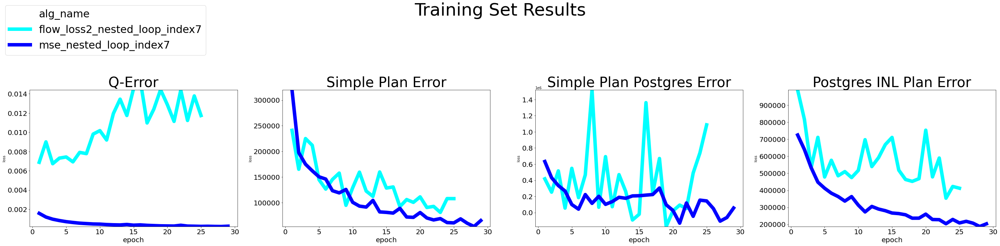

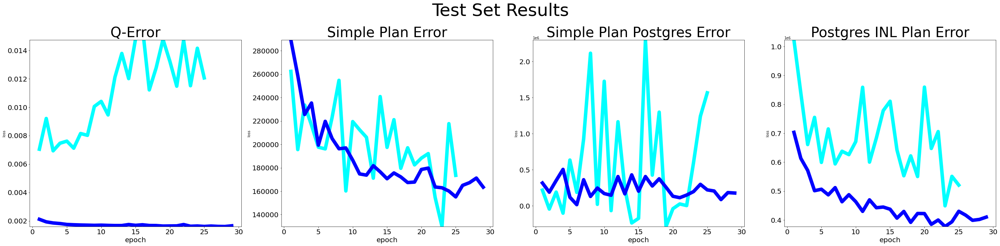

In [14]:
construct_summary(df, "train", "Training Set Results", ERRORS, HUE_COLORS=HUE_COLORS)
construct_summary(df, "test", "Test Set Results", ERRORS, HUE_COLORS=HUE_COLORS)

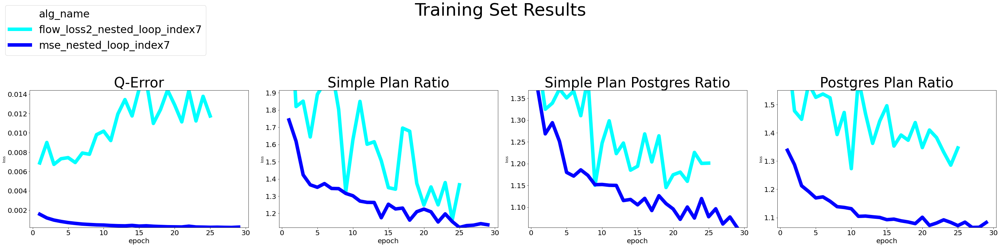

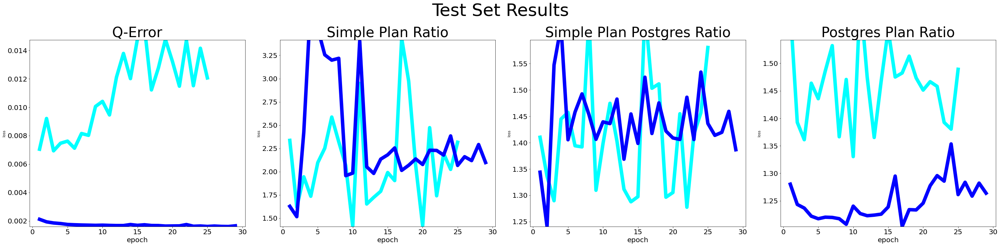

In [15]:
construct_summary(df, "train", "Training Set Results", ERROR_RATIOS, HUE_COLORS=HUE_COLORS)
construct_summary(df, "test", "Test Set Results", ERROR_RATIOS, HUE_COLORS=HUE_COLORS)

# Comparing Ratios with Errors
## Sorted by mean ratio (descending)
## Trying to show that some templates have really high ratios, even though these may not translate to as large plan errors

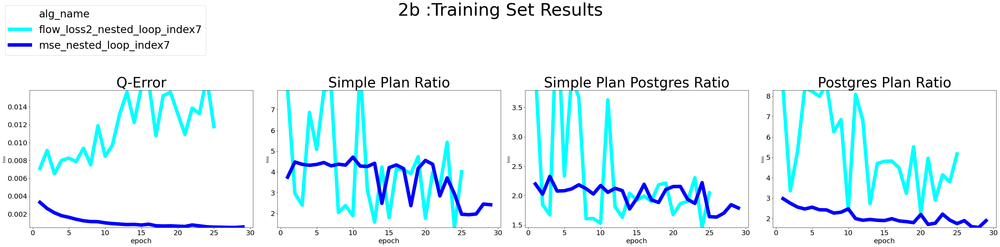

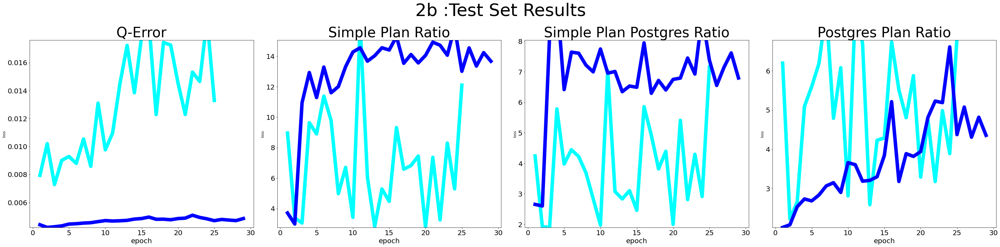

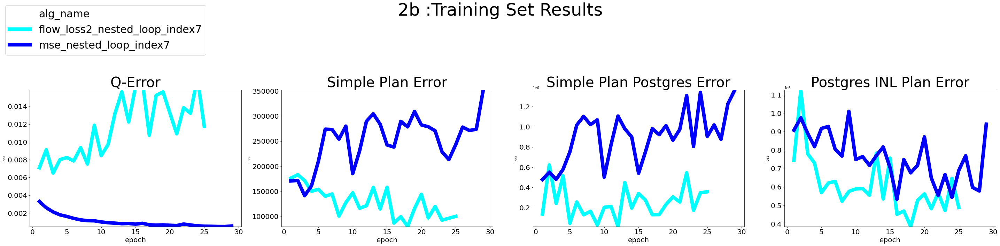

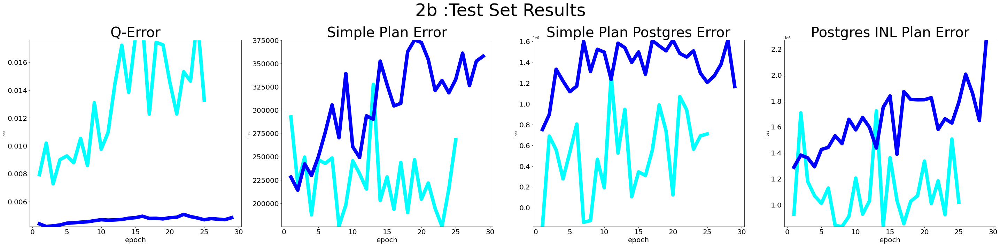

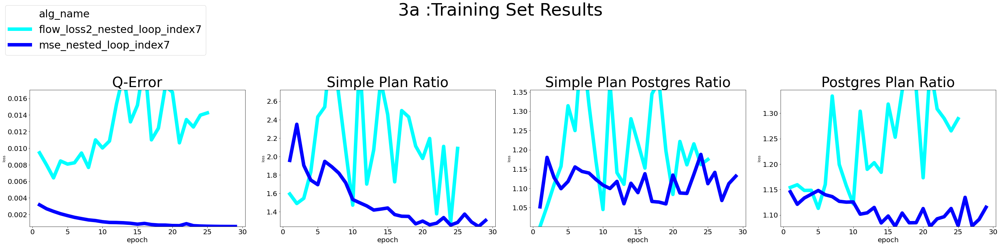

...

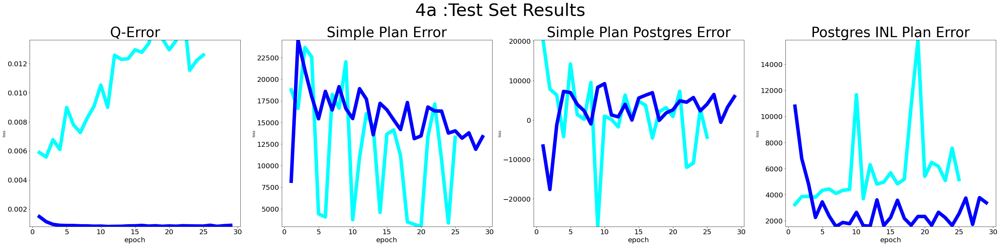

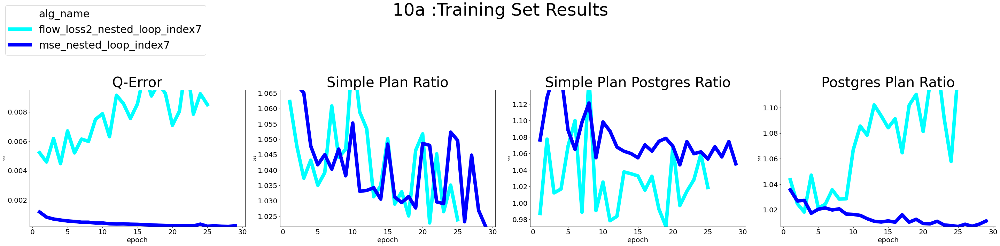

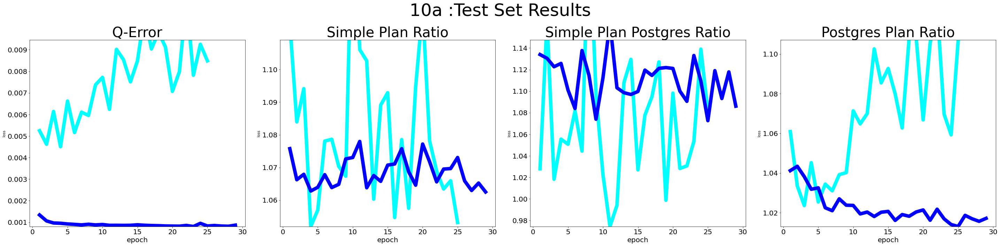

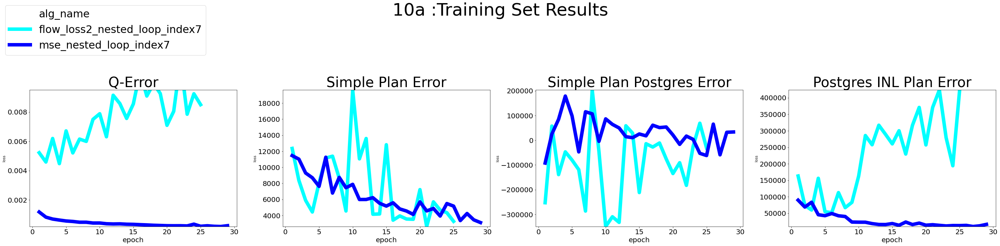

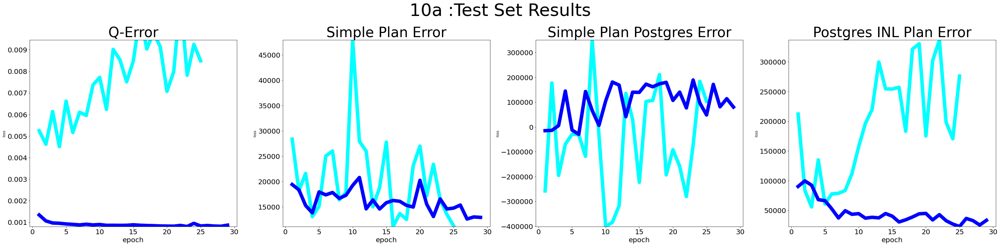

In [17]:
all_tmp_df = all_df[~all_df["loss_type"].str.contains("gradient")]
sort_df = all_tmp_df[all_tmp_df["loss_type"] == "mm1_plan_ratio"]
sgb = sort_df.groupby("template").mean()
template_order = sgb.sort_values(by=["loss"], ascending=False)["loss"]
#print(template_order)

for temp in template_order.index:
    tmp_df = all_df[all_df["template"] == temp]
    tmp_df = tmp_df[tmp_df["num_tables"] == "all"]
    construct_summary(tmp_df, "train", temp + " :Training Set Results", ERROR_RATIOS, HUE_COLORS=HUE_COLORS)
    construct_summary(tmp_df, "test", temp + " :Test Set Results", ERROR_RATIOS, HUE_COLORS=HUE_COLORS)

    construct_summary(tmp_df, "train", temp + " :Training Set Results", ERRORS, HUE_COLORS=HUE_COLORS)
    construct_summary(tmp_df, "test", temp + " :Test Set Results", ERRORS, HUE_COLORS=HUE_COLORS)
    
    

# Gradients wrt Model Parameters (per layer)

* Each column represents a different "layer", 10 layers because:
    * 4 independent fully connected NN, with 1 hidden layer for Table Features, Join Features, Predicate Features, and Flow Features
    * 2 final layers which combines the output of the ones before
* mean (abs (gradient_vec)) where greadient_vec is calculated per query at each update step
* Plotted separately for models because scales somewhat different (not sure...why?!)

In [16]:
param_gradients =  [g for g in set(df["loss_type"]) if "param" in g]
param_gradients.sort()
par_grad_df = df[df["loss_type"].isin(param_gradients)]
algs = set(par_grad_df["alg_name"])
for alg in algs:
    plot_alg_grad(par_grad_df, alg, HUE_COLORS=HUE_COLORS)

# Gradients wrt Model Parameters (per template)

* Each column represents a different template. (so averaging across all layers)
* mean (abs (gradient_vec)) where greadient_vec is calculated per query at each update step

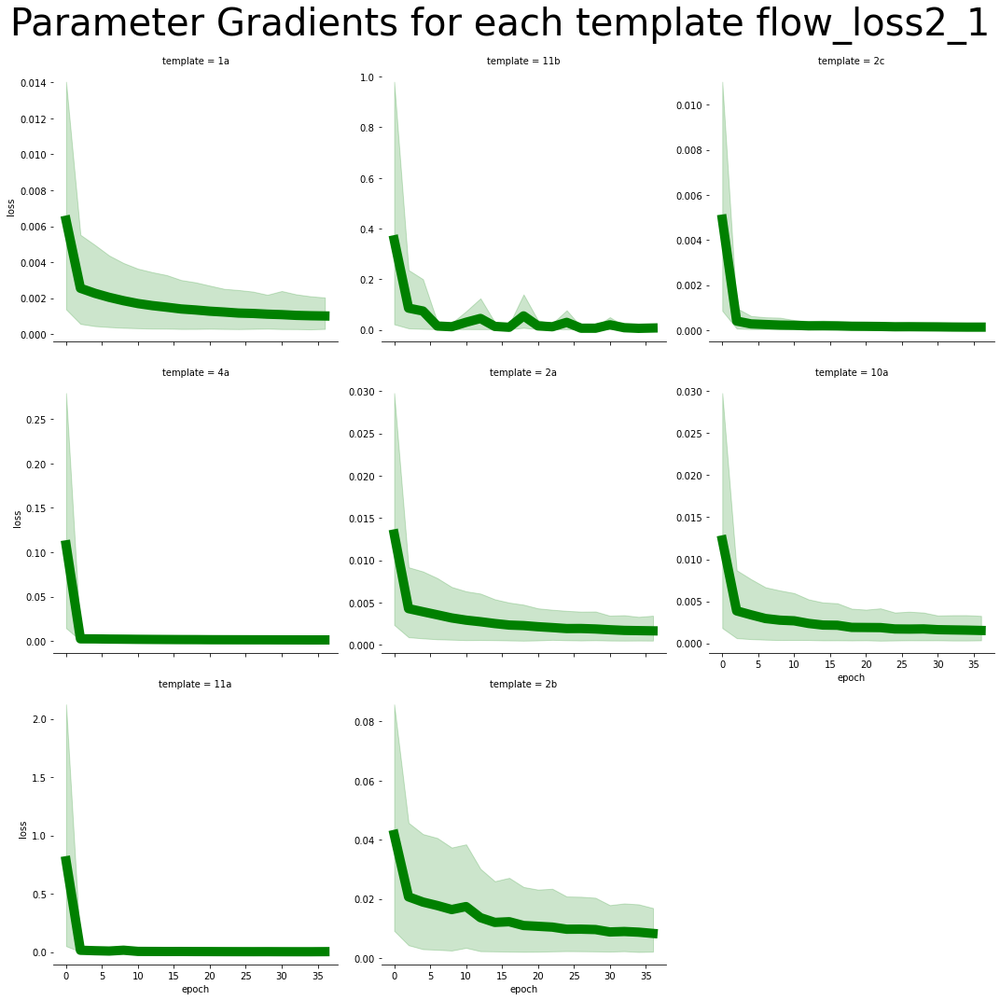

In [100]:
param_gradients =  [g for g in set(df["loss_type"]) if "param" in g]
param_gradients.sort()
par_grad_df = all_df[all_df["loss_type"].isin(param_gradients)]
algs = set(par_grad_df["alg_name"])
for alg in algs:
    plot_tmp_grad(par_grad_df, alg, HUE_COLORS=HUE_COLORS)

# Gradients wrt Model Output

* mean (abs (gradient_vec)) where greadient_vec is calculated per query at each update step

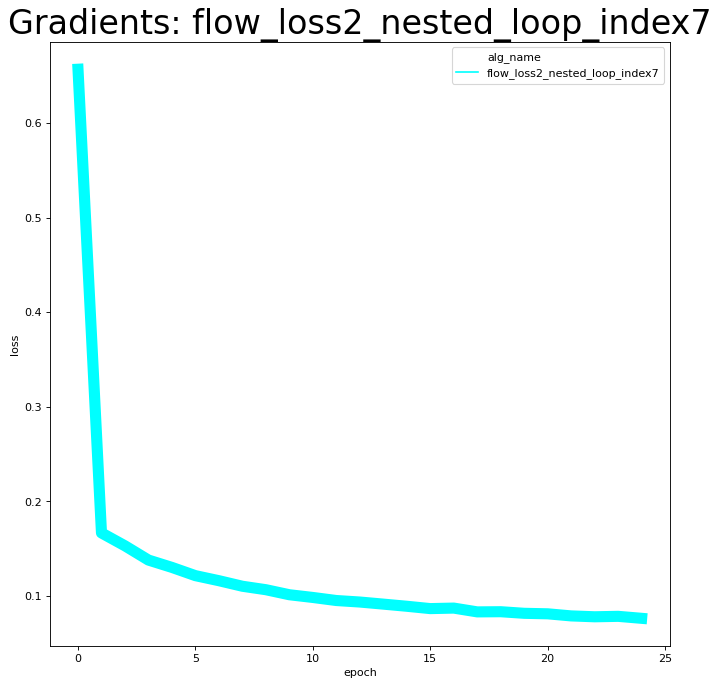

In [18]:
def plot_grad(df, alg_name, ylim):
    fig=plt.figure(figsize=(10, 10), dpi= 80, facecolor='w', edgecolor='k')
    cur_df = df[df["alg_name"] == alg_name]
    #cur_df = cur_df[cur_df["lr"] == lr]
    sns.lineplot(x="epoch", y="loss", data=cur_df, hue="alg_name", palette=HUE_COLORS, ci=None, 
                 linewidth=10.0)
    plt.ylim(ylim)
    alg_name = list(set(cur_df["alg_name"]))[0]
    plt.title("Gradients: " + alg_name, fontsize=30)
    #plt.yscale("log")
    plt.show()
    #plt.clf()

# Gradients
grad_df = df[df["loss_type"] == "gradients"]
algs = set(grad_df["alg_name"])
for alg in algs:
    plot_grad(grad_df, alg, (None, None))

# Loss Results

## Train - Test results over all the losses, and 6000+ queries each in the training / test sets

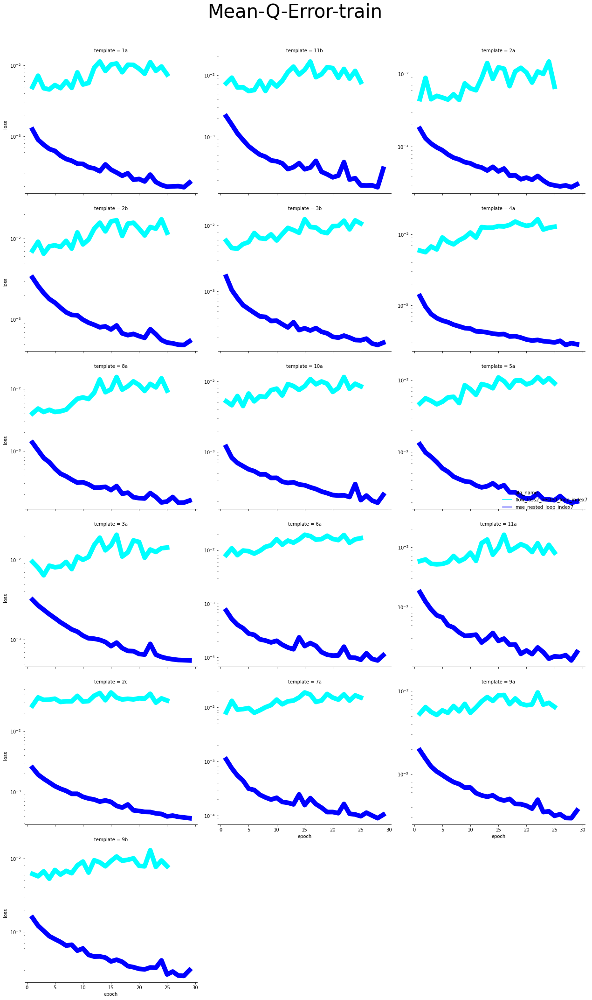

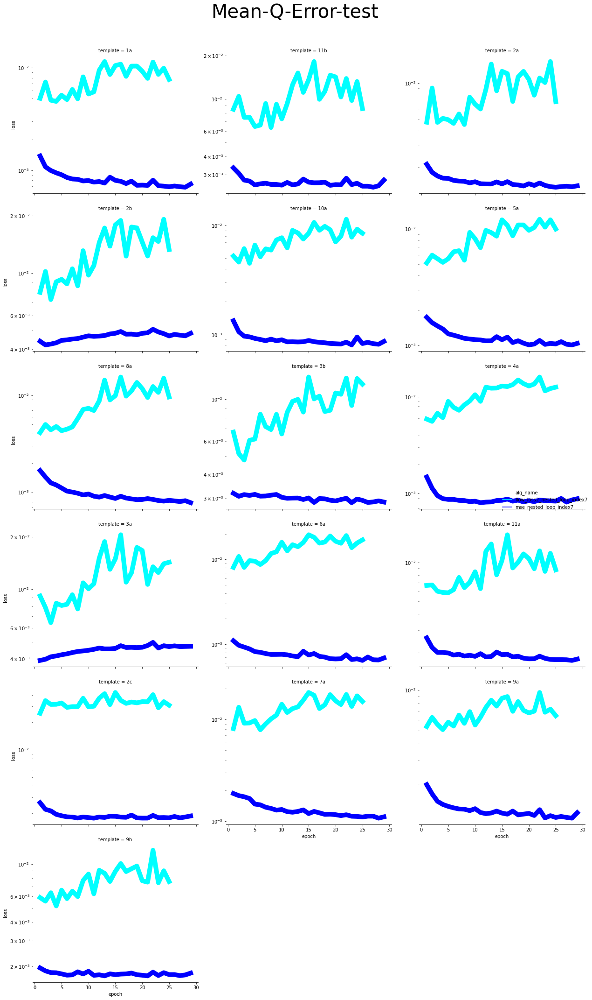

In [19]:
plot_loss_template(all_df, "qerr", "train", "log", HUE_COLORS)
plot_loss_template(all_df, "qerr", "test", "log", HUE_COLORS)

# Flow Error

## Flow_Loss - Optimal_Flow_loss

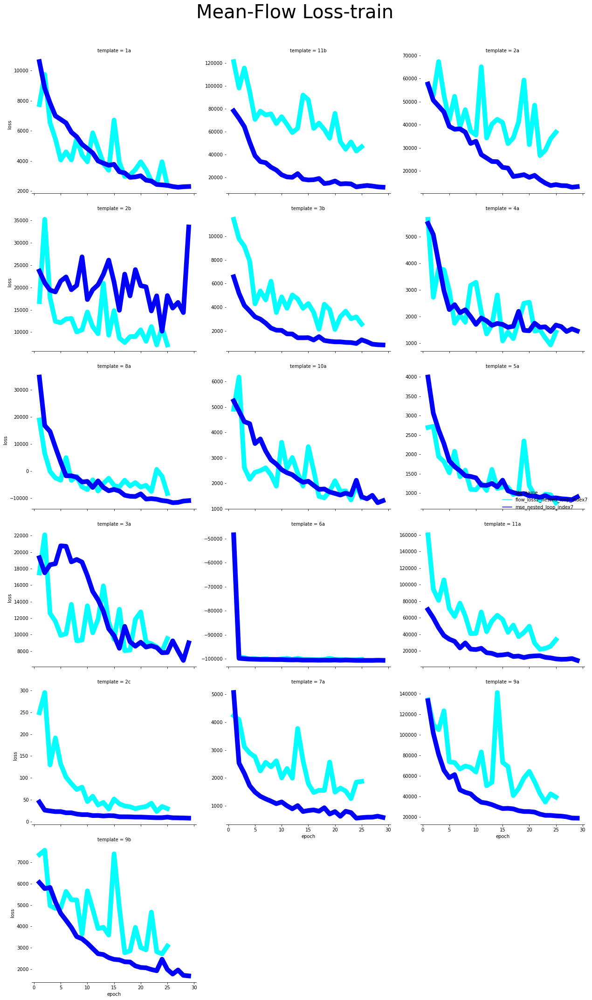

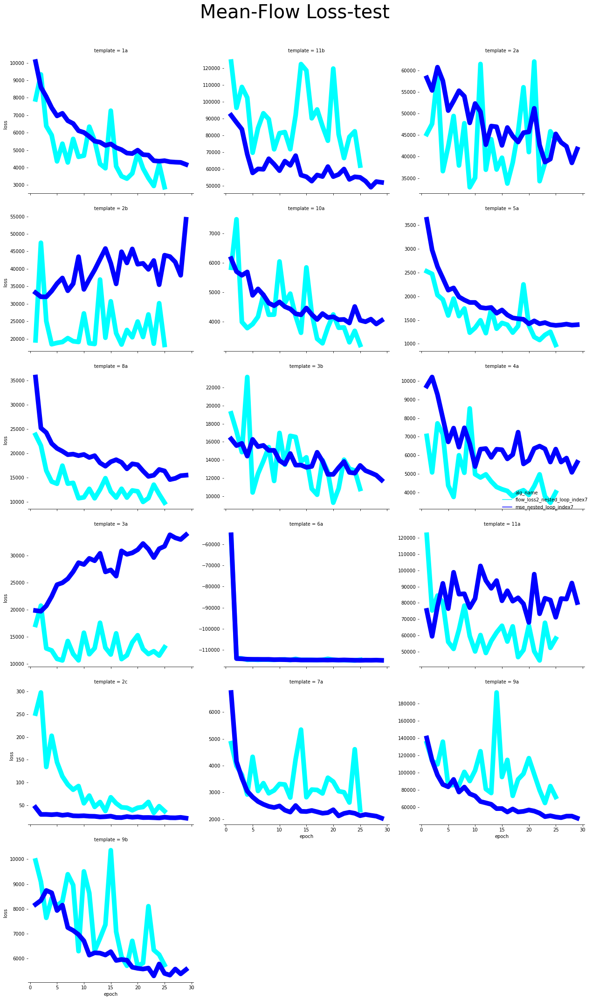

In [20]:
plot_loss_template(all_df, "flow_err", "train", "linear", HUE_COLORS)
plot_loss_template(all_df, "flow_err", "test", "linear", HUE_COLORS)

# Flow Ratio

## Flow_Loss / Optimal_Flow_loss

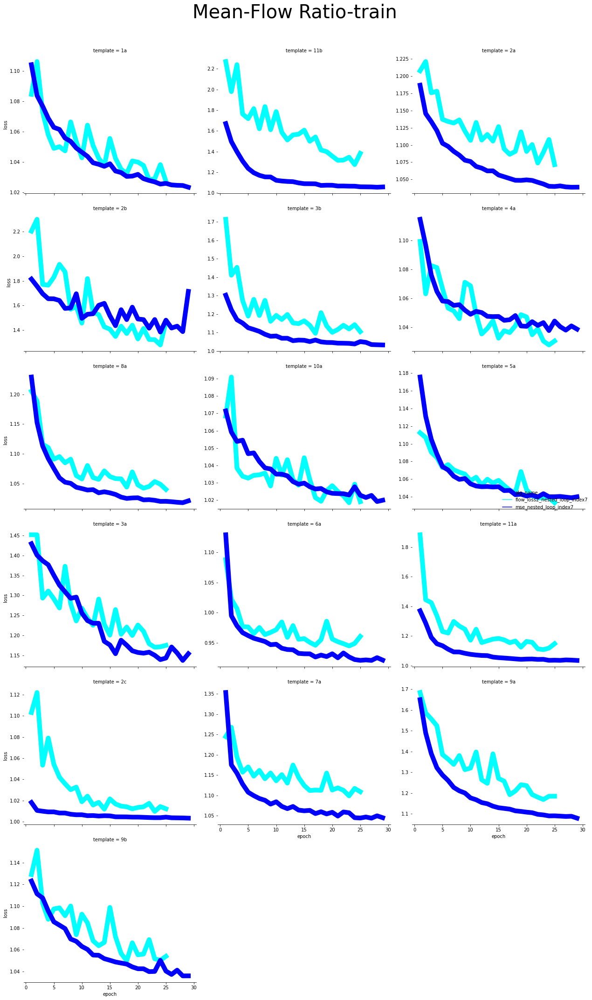

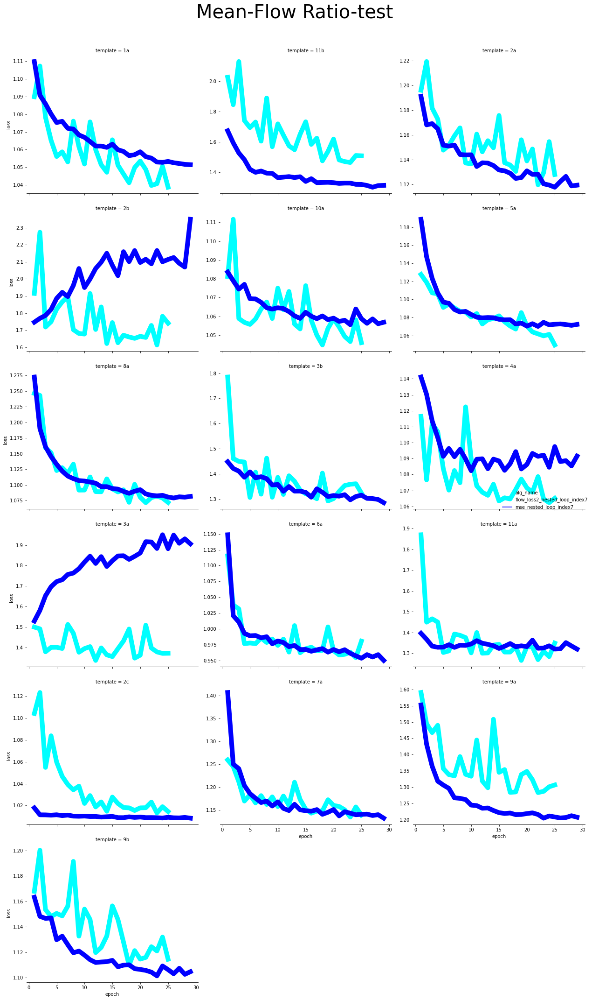

In [21]:
plot_loss_template(all_df, "flow_ratio", "train", "linear", HUE_COLORS)
plot_loss_template(all_df, "flow_ratio", "test", "linear", HUE_COLORS)

# MM1 Cost Model: Plan Error

## Simple Cost model that we used to define flow loss

## Plan Cost  - Optimal Plan Cost

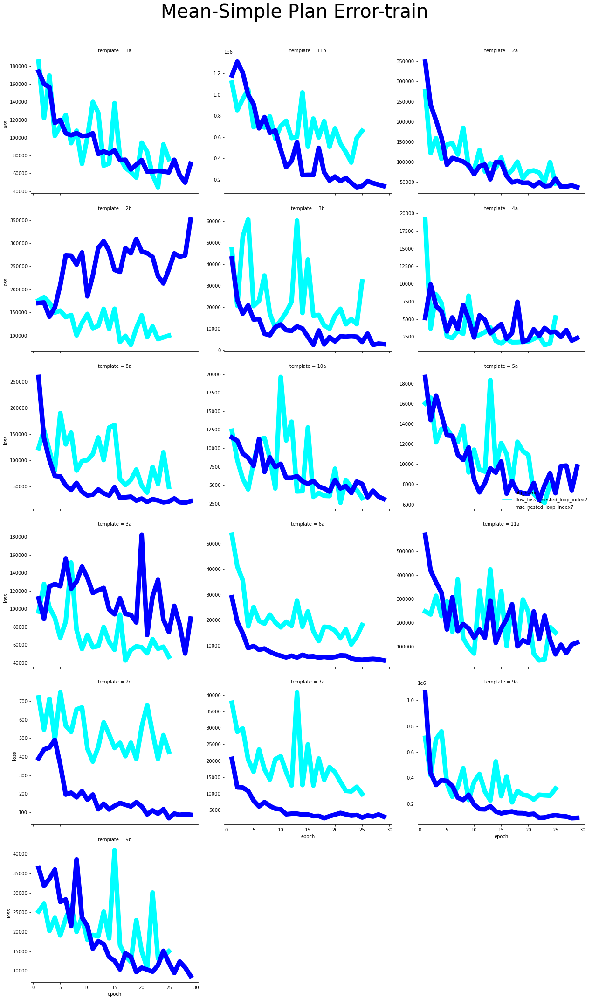

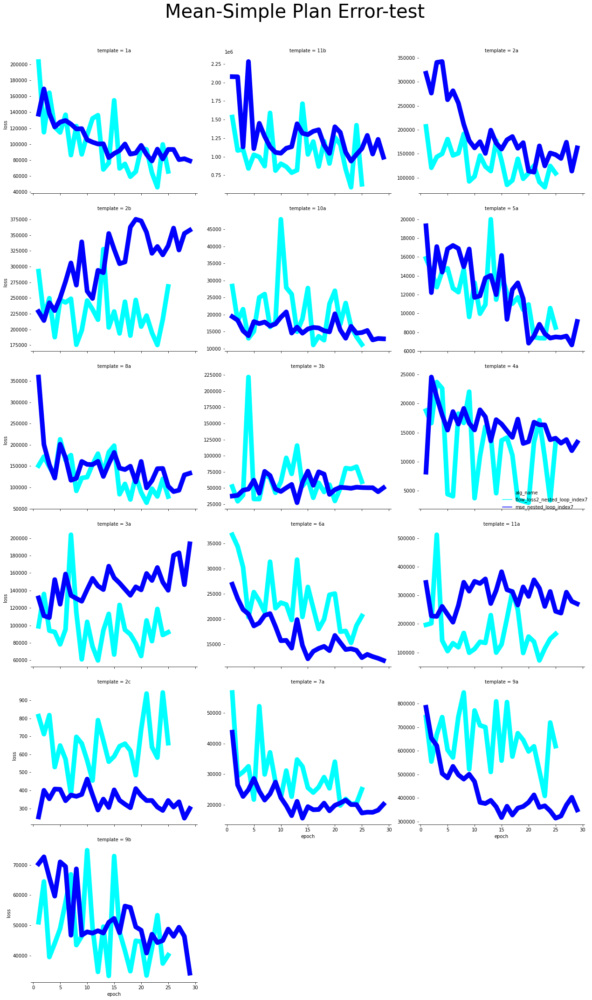

In [22]:
plot_loss_template(all_df, "mm1_plan_err", "train", "linear", HUE_COLORS)
plot_loss_template(all_df, "mm1_plan_err", "test", "linear", HUE_COLORS)

# MM1 Cost Model: Plan Ratio

## Simple Cost model that we used to define flow loss

## Plan Cost  / Optimal Plan Cost

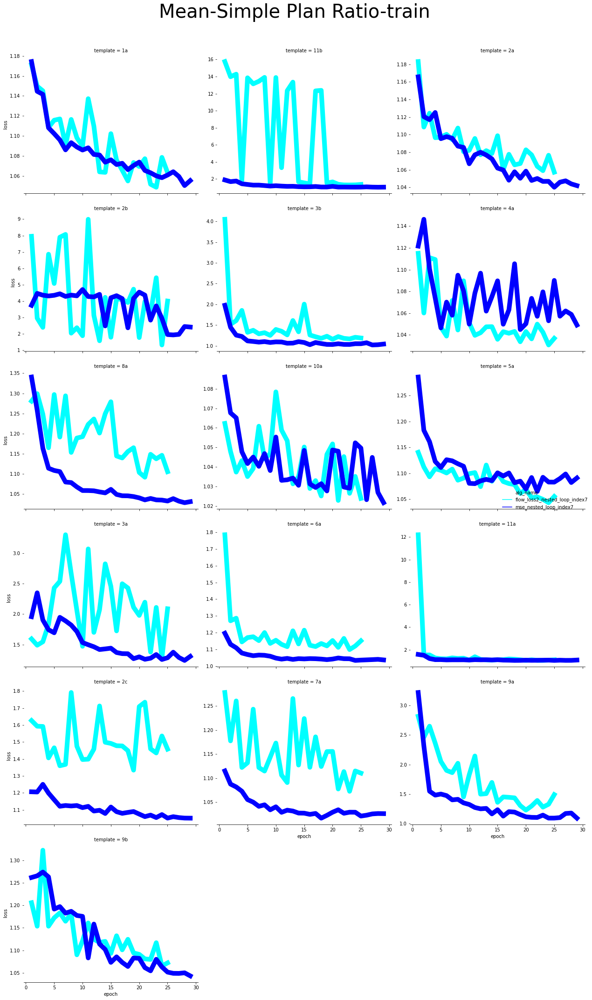

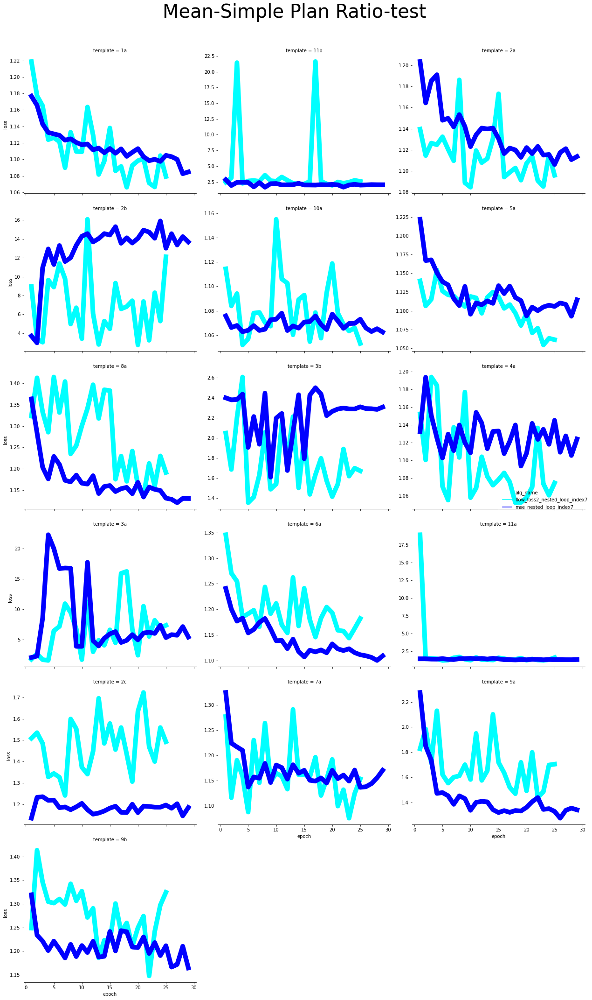

In [23]:
plot_loss_template(all_df, "mm1_plan_ratio", "train", "linear", HUE_COLORS)
plot_loss_template(all_df, "mm1_plan_ratio", "test", "linear", HUE_COLORS)

# Postgres Cost Model based errors

# Simple Cost Model Plan, Postgres Error

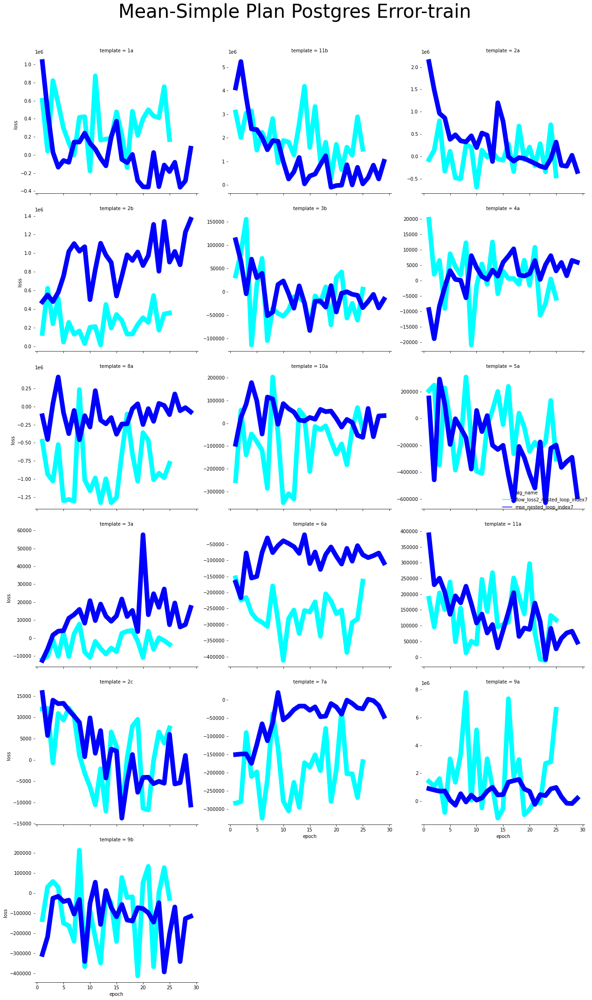

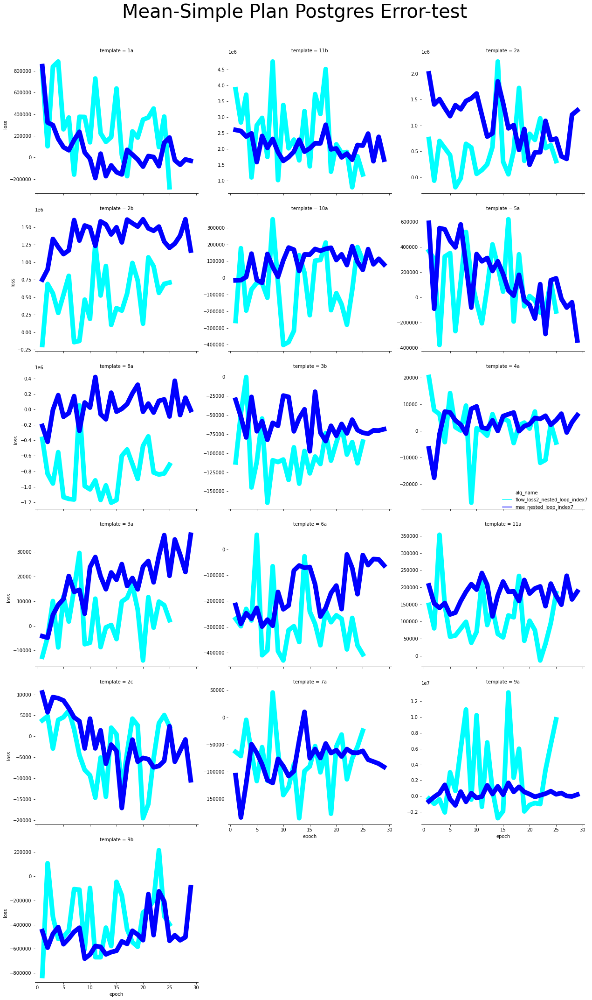

In [24]:
plot_loss_template(all_df, "mm1_plan_pg_err", "train", "linear", HUE_COLORS)
plot_loss_template(all_df, "mm1_plan_pg_err", "test", "linear", HUE_COLORS)

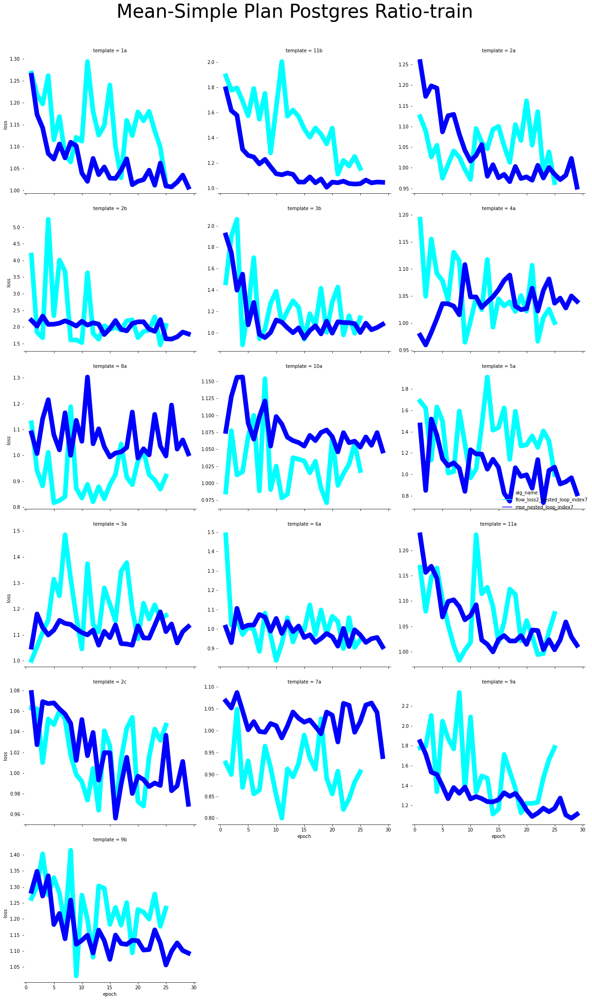

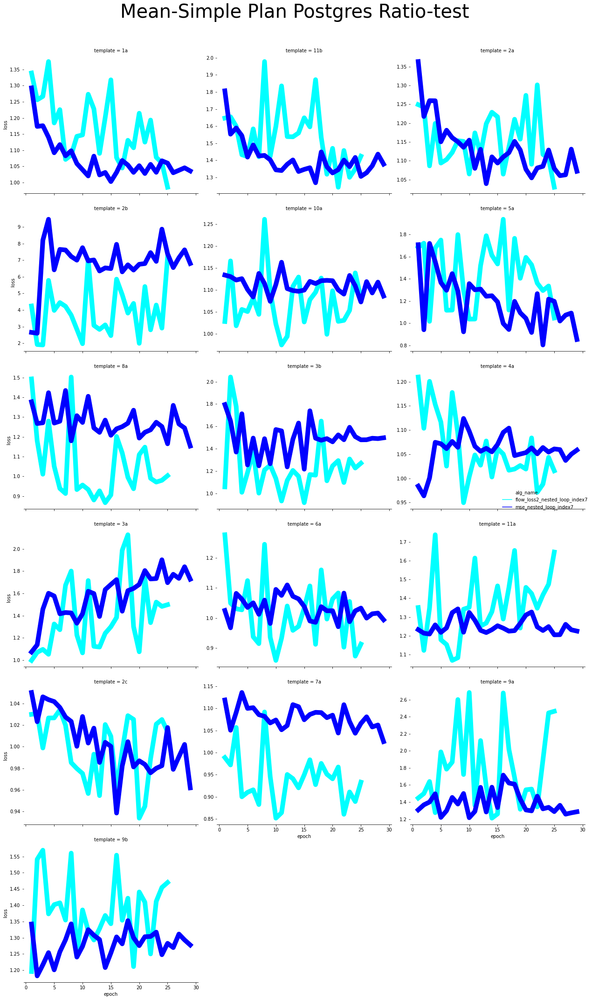

In [25]:
plot_loss_template(all_df, "mm1_plan_pg_ratio", "train", "linear", HUE_COLORS)
plot_loss_template(all_df, "mm1_plan_pg_ratio", "test", "linear", HUE_COLORS)

# Postgres Cost Model for both Plan and Errors

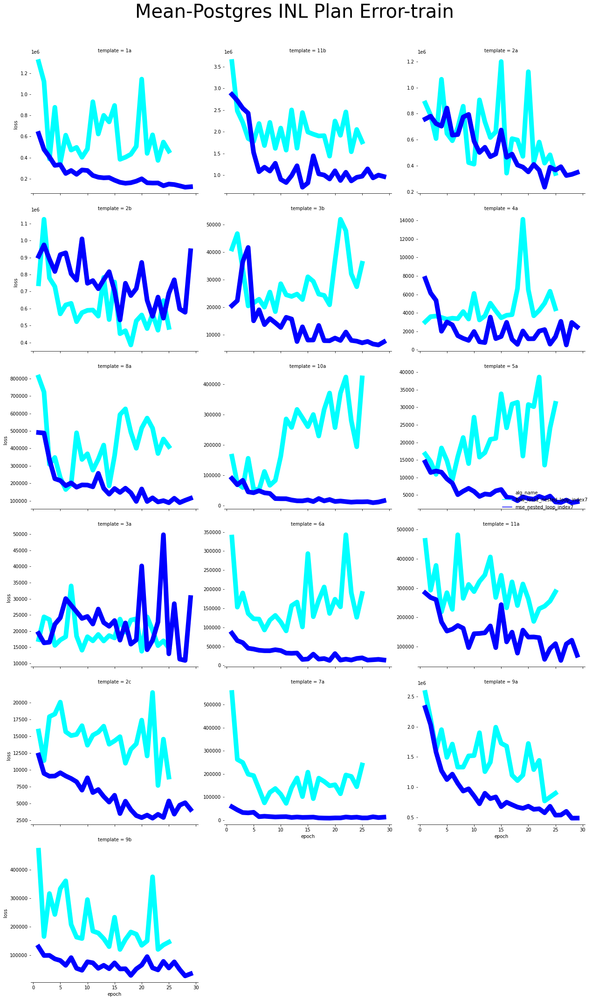

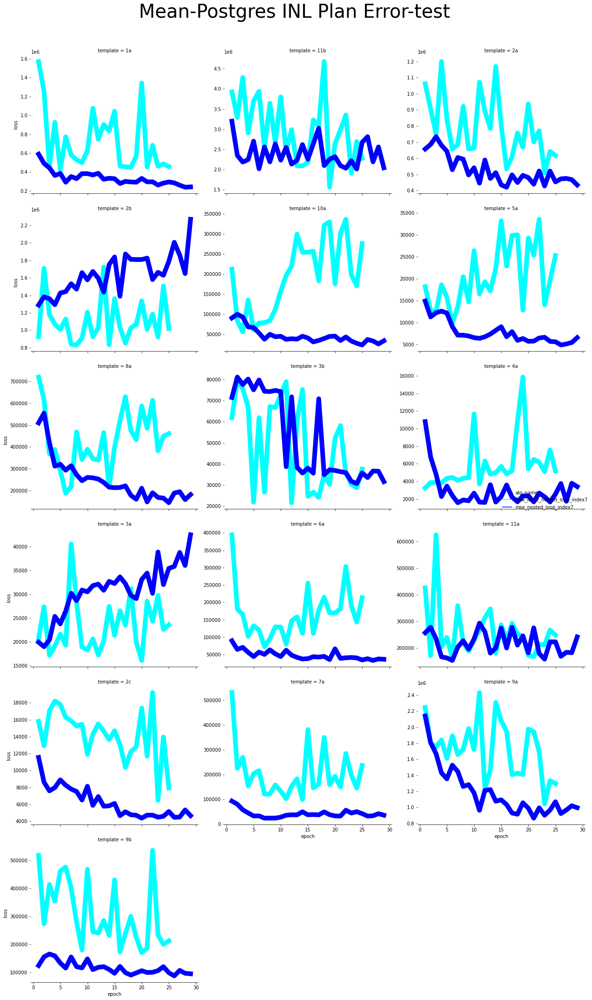

In [26]:
plot_loss_template(all_df, "jerr", "train", "linear", HUE_COLORS)
plot_loss_template(all_df, "jerr", "test", "linear", HUE_COLORS)

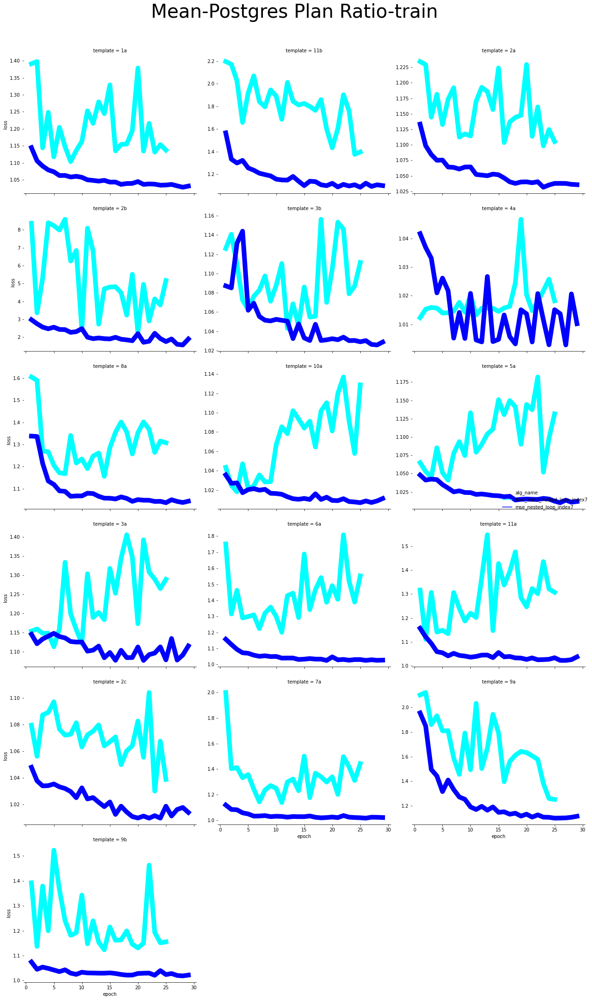

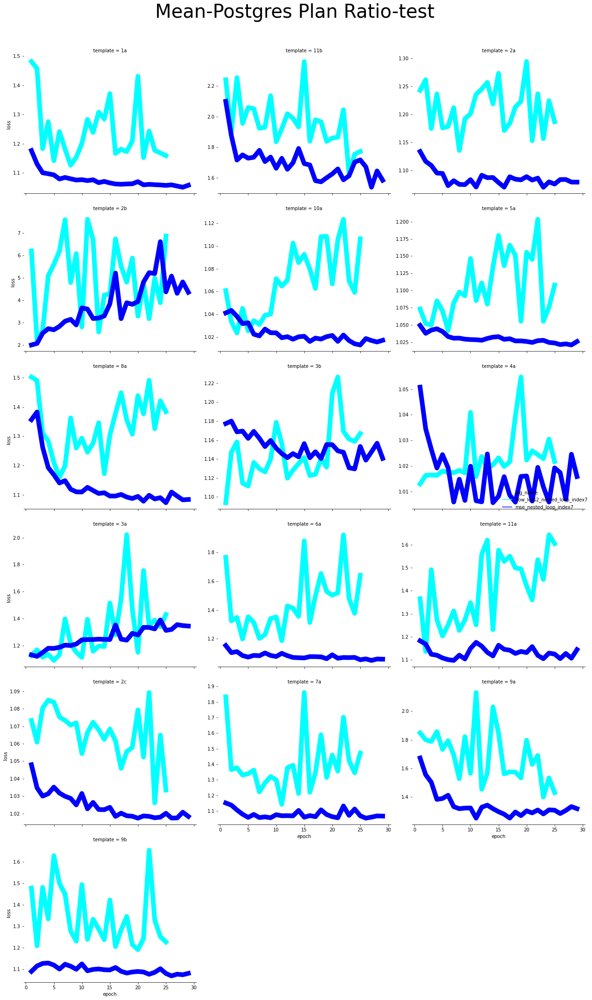

In [27]:
plot_loss_template(all_df, "jerr_ratio", "train", "linear", HUE_COLORS)
plot_loss_template(all_df, "jerr_ratio", "test", "linear", HUE_COLORS)